## Sim Demo

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

  import numpy.matlib as npm

  autumn = cm.get_cmap('autumn', 256)

  winter = cm.get_cmap('winter_r', 256)



In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 3.6%
RAM Usage: 14.0%
Available RAM: 1.3T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

## Simulation tests <a id="sims"></a>

### Model Parameter Counts

#### **Linear Models**
- **PCA Bilinear:** 730  _(27 PCs)_
- **PLS Bilinear:** 101  _(10 PLS components)_
- **Bilinear Low-rank:** 73,800  _(rank 10)_
- **PLS MLP:** 158,993  _(10 PLS components, including PLS projection matrices)_
- **PCA MLP:** 47,873  _(27 PCs, 2-layer)_

---

#### **MLP and SMT Models**

#### 2-Layer Models
- **MLP:** 3,812,609
- **SMT:** 1,399,947
- **MLP w/ CLS:** 3,814,145
- **SMT w/ CLS:** 1,405,579

#### 3-Layer Models
- **MLP:** 7,723,777
- **SMT:** 2,162,315
- **MLP w/ CLS:** 7,726,849
- **SMT w/ CLS:** 2,173,067

---

### Coord MLP Parameter Counts
- **[32]:** 321
- **[64, 32]:** 2,753
- **[128, 64]:** 9,601
- **[256, 128]:** 35,685
- **[512, 256, 128]:** 169,729


Number of regions per lobe:
Frontal: 132
Parietal: 121
Temporal: 95
Occipital: 52
Subcortex: 46
Cerebellum: 10


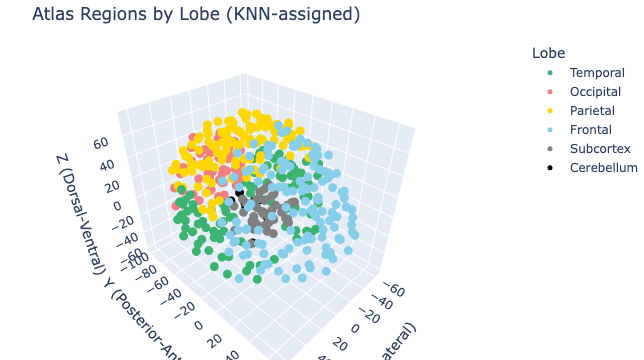

In [19]:
import pandas as pd
import plotly.express as px

# Load updated atlas
df = pd.read_csv("./data/UKBB/atlas-4S456Parcels_dseg_reformatted.csv")

# Fallback hover name if 'parcel_name' is missing
hover_col = "parcel_name" if "parcel_name" in df.columns else "label"
df["hover_label"] = df[hover_col]

# Set unknown lobes to "Unknown"
df["Lobe"] = df["lobe"].fillna("Unknown")

# Count number of regions per lobe
lobe_counts = df["Lobe"].value_counts()
print("\nNumber of regions per lobe:")
for lobe, count in lobe_counts.items():
    print(f"{lobe}: {count}")

# Plot
fig = px.scatter_3d(
    df,
    x="mni_x", y="mni_y", z="mni_z",
    color="Lobe",
    hover_name="hover_label",
    opacity=1,
    color_discrete_map={
        "Frontal": "skyblue",
        "Temporal": "mediumseagreen",
        "Parietal": "gold",
        "Occipital": "lightcoral",
        "Subcortex": "gray",
        "Cerebellum": "black"
    }
)

fig.update_traces(marker=dict(size=5))
fig.update_layout(
    title="Atlas Regions by Lobe (KNN-assigned)",
    scene=dict(
        xaxis_title="X (Lateral)",
        yaxis_title="Y (Posterior-Anterior)",
        zaxis_title="Z (Dorsal-Ventral)"
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Lobe coverage: 100.0% of regions
Lobe sizes: {'Temporal': 95, 'Occipital': 52, 'Parietal': 121, 'Frontal': 132, 'Subcortex': 46, 'Cerebellum': 9}
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: kcbk2t9t
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/kcbk2t9t
Initialized sweep with ID: kcbk2t9t



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Testing network: Temporal
Occipital
Parietal
Frontal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'epochs': 90, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT model: 2162315



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 0.0436
Best val loss so far at epoch 4: 0.0385
Epoch 5/90, Train Loss: 0.0733, Val Loss: 0.0388, Time: 3.67s
Best val loss so far at epoch 6: 0.0343
Best val loss so far at epoch 7: 0.0314
Best val loss so far at epoch 8: 0.0276
Best val loss so far at epoch 9: 0.0259
Epoch 10/90, Train Loss: 0.0450, Val Loss: 0.0265, Time: 3.68s
Epoch 15/90, Train Loss: 0.0292, Val Loss: 0.0293, Time: 3.62s
Best val loss so far at epoch 17: 0.0258
Best val loss so far at epoch 19: 0.0253
Epoch 20/90, Train Loss: 0.0257, Val Loss: 0.0260, Time: 3.53s
Best val loss so far at epoch 24: 0.0253
Epoch 25/90, Train Loss: 0.0183, Val Loss: 0.0266, Time: 3.34s
Best val loss so far at epoch 28: 0.0252
Best val loss so far at epoch 29: 0.0247
Epoch 30/90, Train Loss: 0.0186, Val Loss: 0.0257, Time: 3.51s
Best val loss so far at epoch 31: 0.0239
Epoch 35/90, Train Loss

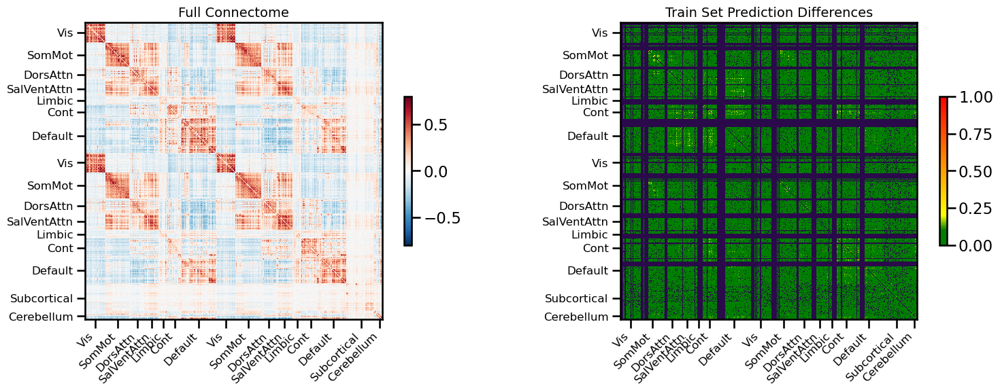

<Figure size 640x480 with 0 Axes>

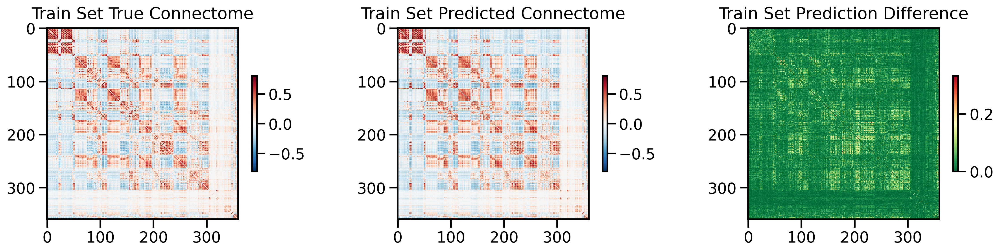

<Figure size 640x480 with 0 Axes>

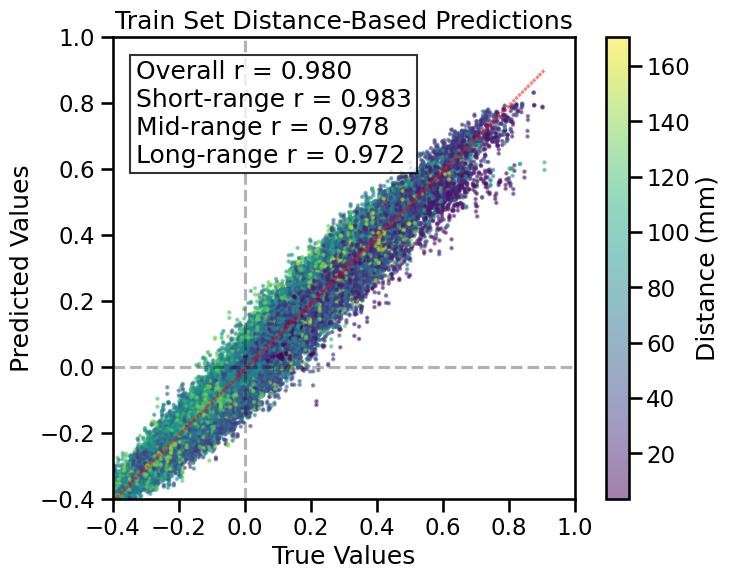

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 95 regions, 8930 connections


<Figure size 640x480 with 0 Axes>

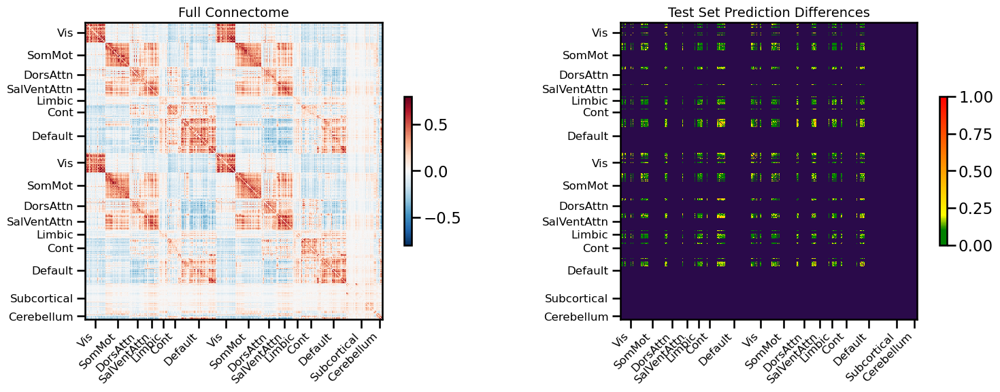

<Figure size 640x480 with 0 Axes>

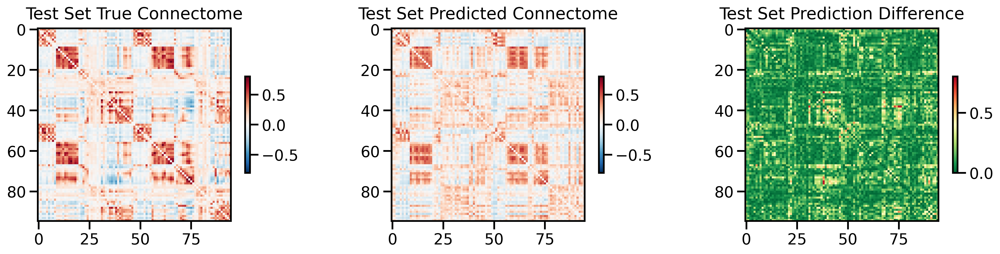

<Figure size 640x480 with 0 Axes>

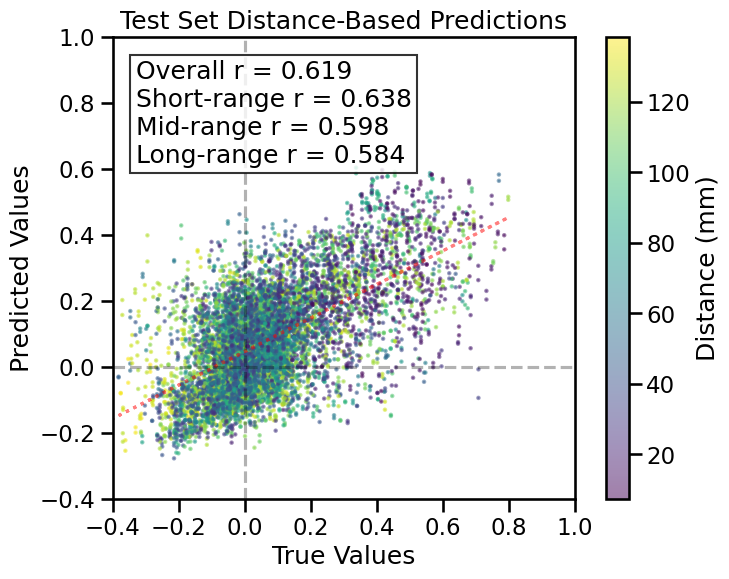

TRAIN METRICS
GLOBAL: mse=0.001506, mae=0.027723, r2=0.9581, pearson_r=0.9803, spearman_r=0.9761, geodesic_distance=14.1745
DISTANCE-BASED: short=0.9828, mid=0.9776, long=0.9724
HEMISPHERIC: left=0.9798, right=0.9846, inter=0.9834
CONNECTION STRENGTH: neg=0.7071, weak=0.9649, pos=0.8643
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9802    0.9826
  Default       0.9861    0.9843
  SalVentAttn    0.9815    0.9838
  Limbic        0.9783    0.9794
  DorsAttn      0.9818    0.9858
  SomMot        0.9870    0.9881
  Vis           0.9949    0.9895
  Subcortical    0.9837    0.9811
  Cerebellum    0.9680    0.9822

TEST METRICS
GLOBAL: mse=0.023456, mae=0.113982, r2=0.3395, pearson_r=0.6189, spearman_r=0.5696, geodesic_distance=11.6123
DISTANCE-BASED: short=0.6380, mid=0.5979, long=0.5839
HEMISPHERIC: left=0.6187, right=0.6086, inter=0.6181
CONNECTION STRENGTH: weak=0.4764, pos=0.2515
NETWORK CORRELATIONS:
  NETWORK      INTRA      IN


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,█▆▅▅▄▂▂▂▃▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▆▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.02383
train_mse_loss,0.00294


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: xrkuehh2
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/xrkuehh2
Initialized sweep with ID: xrkuehh2



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.




Testing network: Occipital
Temporal
Parietal
Frontal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'epochs': 90, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT model: 2162315



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.1801
Best val loss so far at epoch 2: 0.1147
Best val loss so far at epoch 3: 0.1127
Epoch 5/90, Train Loss: 0.0710, Val Loss: 0.1551, Time: 4.40s
Epoch 10/90, Train Loss: 0.0383, Val Loss: 0.1594, Time: 4.21s
Epoch 15/90, Train Loss: 0.0349, Val Loss: 0.1497, Time: 6.66s
Epoch 20/90, Train Loss: 0.0260, Val Loss: 0.1162, Time: 4.29s
Best val loss so far at epoch 22: 0.1114
Best val loss so far at epoch 23: 0.0897
Best val loss so far at epoch 24: 0.0817
Epoch 25/90, Train Loss: 0.0238, Val Loss: 0.0829, Time: 4.41s
Best val loss so far at epoch 26: 0.0786
Best val loss so far at epoch 27: 0.0658
Best val loss so far at epoch 30: 0.0625
Epoch 30/90, Train Loss: 0.0200, Val Loss: 0.0625, Time: 4.20s
Best val loss so far at epoch 32: 0.0569
Best val loss so far at epoch 35: 0.0502
Epoch 35/90, Train Loss: 0.0185, Val Loss: 0.0502, Time: 4.20

<Figure size 640x480 with 0 Axes>

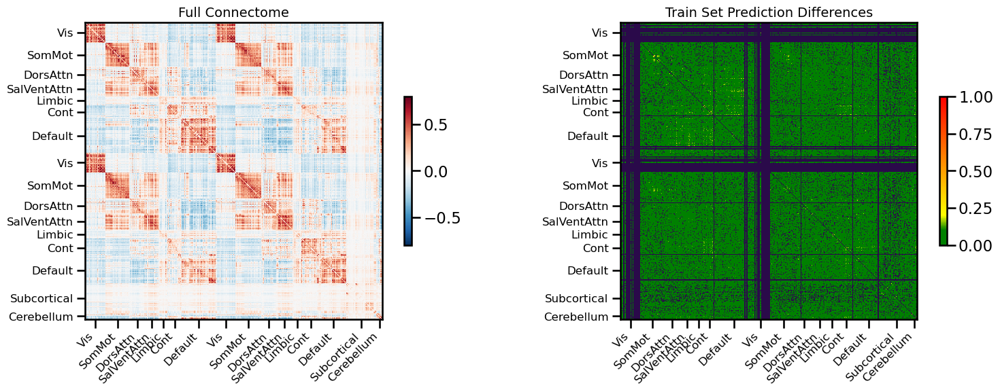

<Figure size 640x480 with 0 Axes>

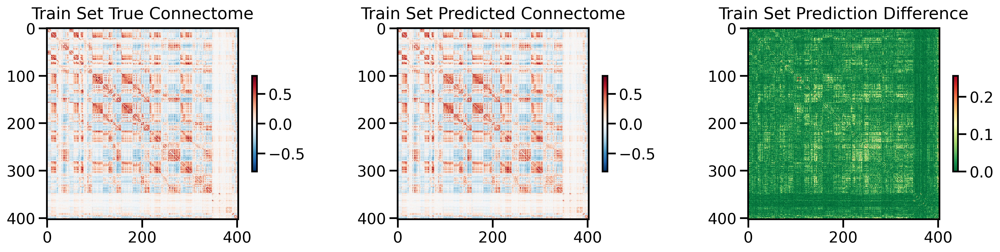

<Figure size 640x480 with 0 Axes>

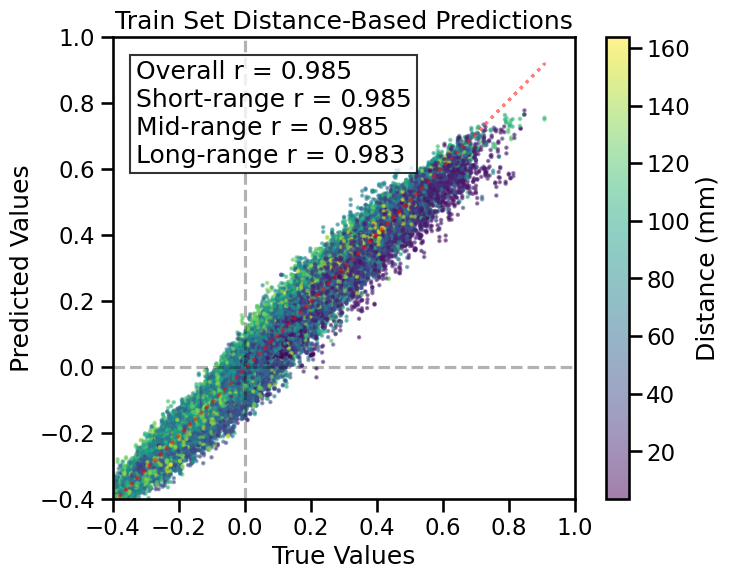

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 52 regions, 2652 connections


<Figure size 640x480 with 0 Axes>

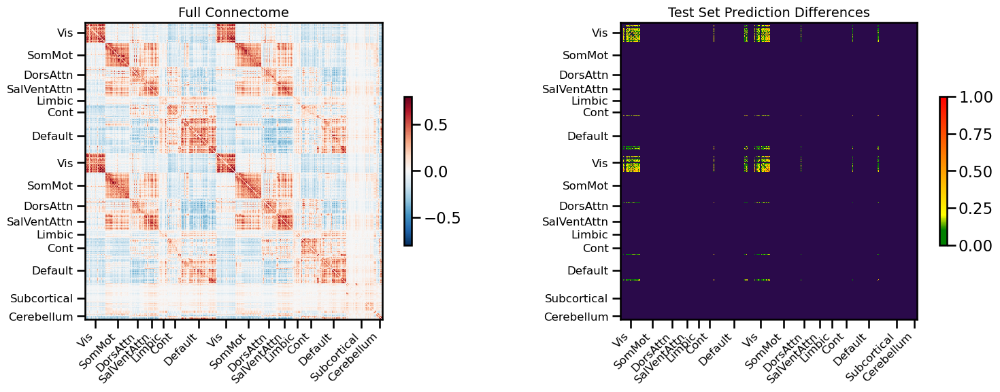

<Figure size 640x480 with 0 Axes>

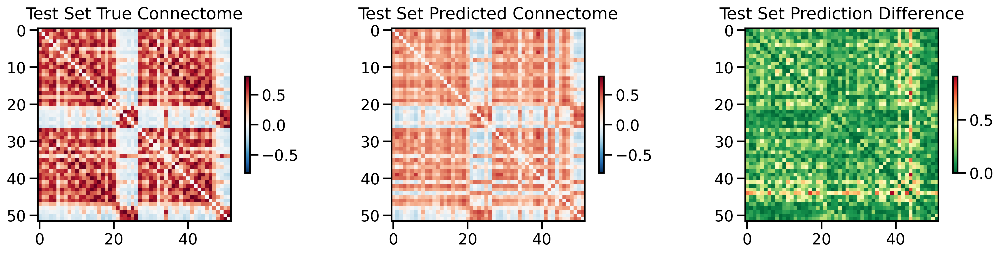

<Figure size 640x480 with 0 Axes>

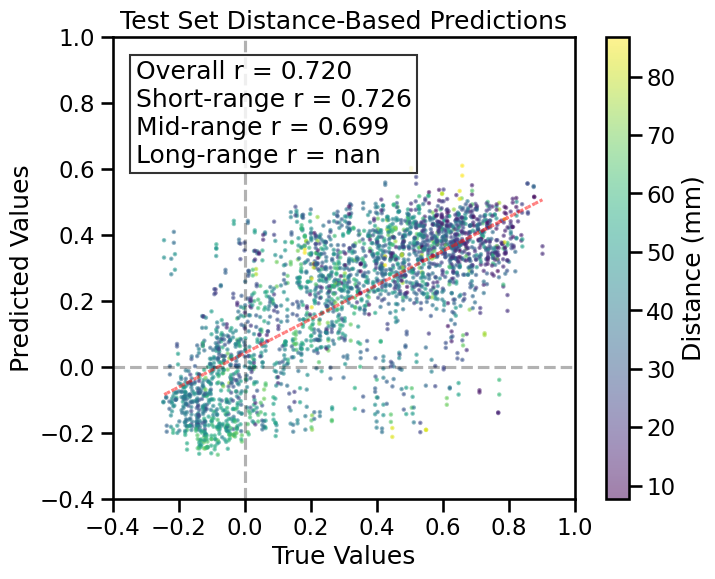

TRAIN METRICS
GLOBAL: mse=0.001090, mae=0.023973, r2=0.9666, pearson_r=0.9847, spearman_r=0.9809, geodesic_distance=14.5334
DISTANCE-BASED: short=0.9851, mid=0.9847, long=0.9834
HEMISPHERIC: left=0.9837, right=0.9884, inter=0.9873
CONNECTION STRENGTH: neg=0.7633, weak=0.9743, pos=0.8776
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9902    0.9879
  Default       0.9879    0.9874
  SalVentAttn    0.9878    0.9877
  Limbic        0.9926    0.9912
  DorsAttn      0.9840    0.9858
  SomMot        0.9837    0.9861
  Vis           0.9715    0.9717
  Subcortical    0.9937    0.9881
  Cerebellum    0.8282    0.9881

TEST METRICS
GLOBAL: mse=0.053701, mae=0.182257, r2=0.3844, pearson_r=0.7200, spearman_r=0.6934, geodesic_distance=7.8720
DISTANCE-BASED: short=0.7260, mid=0.6985
HEMISPHERIC: left=0.7978, right=0.6270, inter=0.7197
CONNECTION STRENGTH: weak=0.6422, pos=0.2539
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  --------


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,▅▇█▇▇▇▇▇▆▆▃▂▂▂▂▂▁▁▁▁▂▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
train_mse_loss,█▇▆▅▅▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.05549
train_mse_loss,0.00229


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: nbxayqt0
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/nbxayqt0
Initialized sweep with ID: nbxayqt0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.




Testing network: Parietal
Temporal
Occipital
Frontal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'epochs': 90, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT model: 2162315



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.0712
Best val loss so far at epoch 2: 0.0697
Best val loss so far at epoch 4: 0.0685
Best val loss so far at epoch 5: 0.0668
Epoch 5/90, Train Loss: 0.0893, Val Loss: 0.0668, Time: 3.50s
Best val loss so far at epoch 6: 0.0667
Best val loss so far at epoch 8: 0.0653
Best val loss so far at epoch 9: 0.0650
Best val loss so far at epoch 10: 0.0634
Epoch 10/90, Train Loss: 0.0533, Val Loss: 0.0634, Time: 3.24s
Best val loss so far at epoch 11: 0.0610
Best val loss so far at epoch 12: 0.0598
Best val loss so far at epoch 13: 0.0579
Best val loss so far at epoch 14: 0.0551
Best val loss so far at epoch 15: 0.0508
Epoch 15/90, Train Loss: 0.0429, Val Loss: 0.0508, Time: 3.31s
Best val loss so far at epoch 16: 0.0445
Best val loss so far at epoch 17: 0.0405
Best val loss so far at epoch 18: 0.0394
Best val loss so far at epoch 19: 0.0372
Best val

<Figure size 640x480 with 0 Axes>

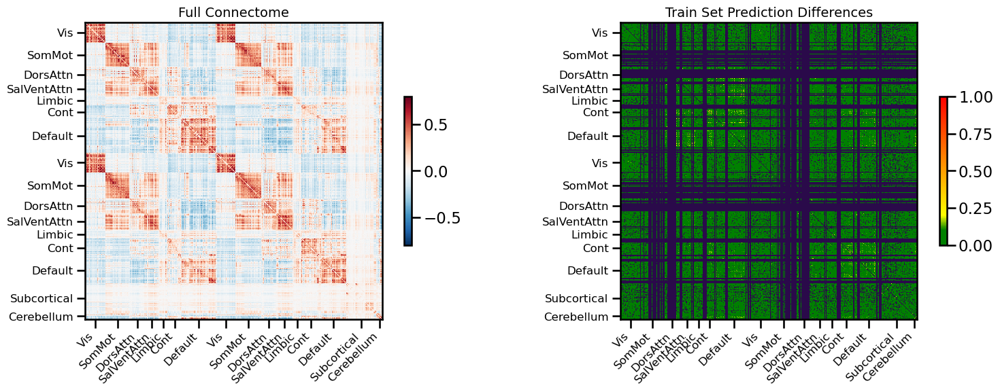

<Figure size 640x480 with 0 Axes>

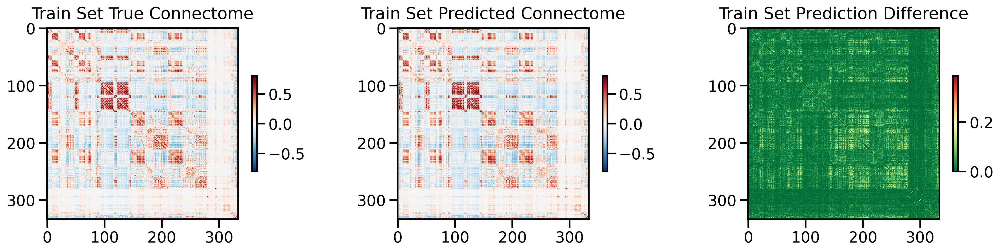

<Figure size 640x480 with 0 Axes>

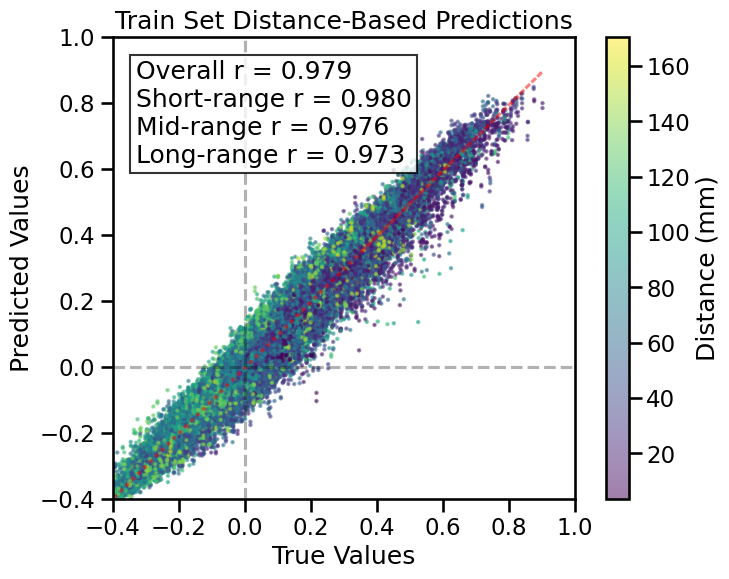

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 121 regions, 14520 connections


<Figure size 640x480 with 0 Axes>

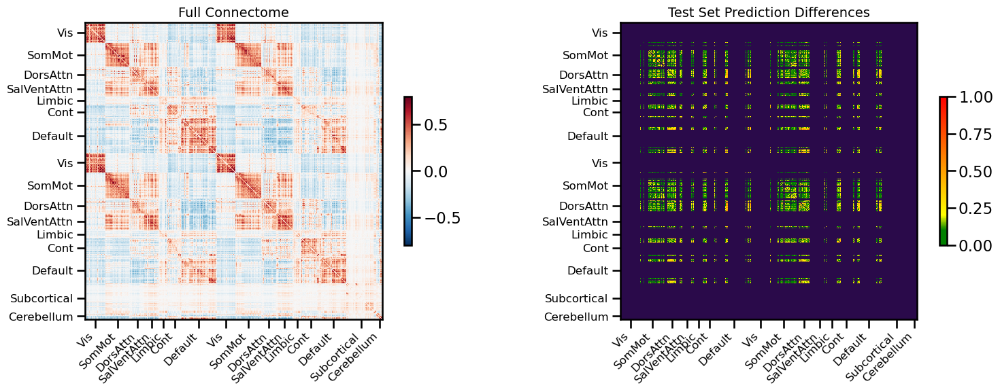

<Figure size 640x480 with 0 Axes>

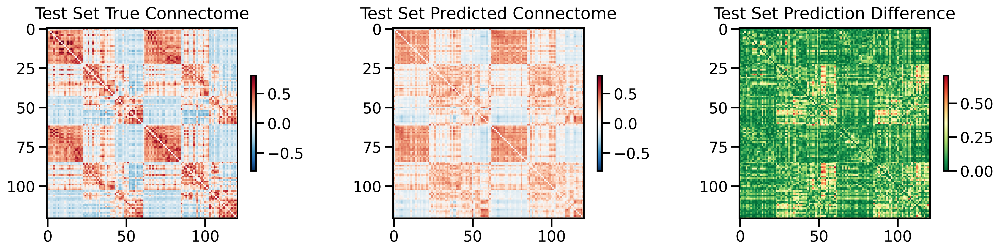

<Figure size 640x480 with 0 Axes>

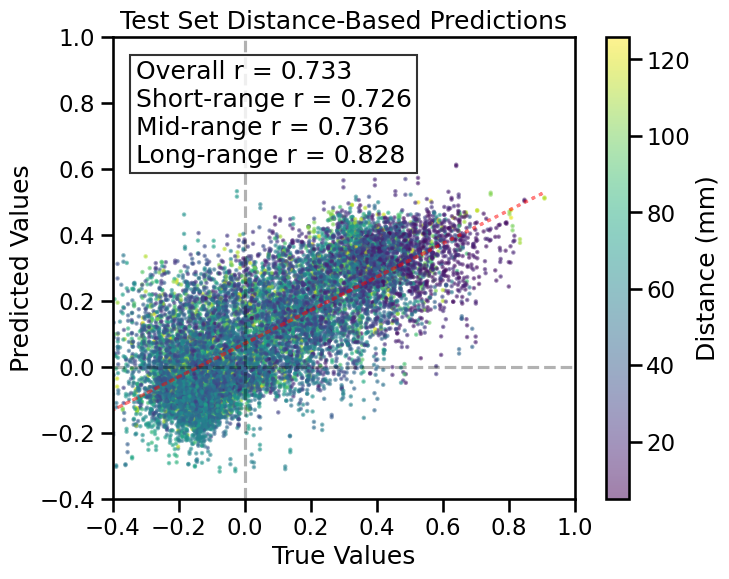

TRAIN METRICS
GLOBAL: mse=0.001357, mae=0.025886, r2=0.9564, pearson_r=0.9788, spearman_r=0.9709, geodesic_distance=15.4525
DISTANCE-BASED: short=0.9798, mid=0.9762, long=0.9729
HEMISPHERIC: left=0.9769, right=0.9809, inter=0.9827
CONNECTION STRENGTH: neg=0.7026, weak=0.9609, pos=0.8859
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9868    0.9791
  Default       0.9654    0.9768
  SalVentAttn    0.9666    0.9746
  Limbic        0.9857    0.9845
  DorsAttn      0.9918    0.9871
  SomMot        0.9849    0.9830
  Vis           0.9772    0.9826
  Subcortical    0.9947    0.9781
  Cerebellum    0.9100    0.9836

TEST METRICS
GLOBAL: mse=0.030745, mae=0.134886, r2=0.5120, pearson_r=0.7325, spearman_r=0.7135, geodesic_distance=10.8381
DISTANCE-BASED: short=0.7259, mid=0.7363, long=0.8275
HEMISPHERIC: left=0.6981, right=0.7598, inter=0.7381
CONNECTION STRENGTH: neg=-0.0433, weak=0.5845, pos=0.2333
NETWORK CORRELATIONS:
  NETWORK      


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,██▇▇▇▆▃▃▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.03169
train_mse_loss,0.00266


Final evaluation metrics logged successfully.
CPU Usage: 2.1%
RAM Usage: 16.5%
Available RAM: 1.2T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 1096.05 seconds (18.27 minutes)


8331

<Figure size 640x480 with 0 Axes>

In [20]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='lobe',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True, 
              null_model='none',
              use_folds=[0, 1, 2]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Lobe coverage: 100.0% of regions
Lobe sizes: {'Temporal': 95, 'Occipital': 52, 'Parietal': 121, 'Frontal': 132, 'Subcortex': 46, 'Cerebellum': 9}
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 2knis5qd
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/2knis5qd
Initialized sweep with ID: 2knis5qd



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Testing network: Temporal
Occipital
Parietal
Frontal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'epochs': 90, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 2173067



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.07 GB


W0726 14:36:11.149000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/13] ps1 is not in var_ranges, defaulting to unknown range.
W0726 14:36:11.154000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/13] ps1 is not in var_ranges, defaulting to unknown range.
W0726 14:36:22.891000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/14] ps1 is not in var_ranges, defaulting to unknown range.
W0726 14:36:22.896000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/14] ps1 is not in var_ranges, defaulting to unknown range.


Best val loss so far at epoch 1: 0.0443
Best val loss so far at epoch 2: 0.0361
Best val loss so far at epoch 3: 0.0343
Best val loss so far at epoch 4: 0.0333
Best val loss so far at epoch 5: 0.0314
Epoch 5/90, Train Loss: 0.0776, Val Loss: 0.0314, Time: 4.17s
Best val loss so far at epoch 6: 0.0303
Best val loss so far at epoch 8: 0.0299
Epoch 10/90, Train Loss: 0.0474, Val Loss: 0.0319, Time: 5.51s
Epoch 15/90, Train Loss: 0.0327, Val Loss: 0.0343, Time: 4.08s
Epoch 20/90, Train Loss: 0.0309, Val Loss: 0.0319, Time: 5.54s
Best val loss so far at epoch 21: 0.0296
Best val loss so far at epoch 23: 0.0291
Best val loss so far at epoch 25: 0.0283
Epoch 25/90, Train Loss: 0.0194, Val Loss: 0.0283, Time: 3.89s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.028757
Best val loss so far at epoch 27: 0.0276
Epoch 30/90, Train Loss: 0.0177, Val Loss: 0.0298, Time: 3.99s
Best val loss so far at epoch 31: 0.0268
Best val loss so far at epoch 34: 0.0268
Epoch 35/90, Train Loss: 0.0190, Val Loss:

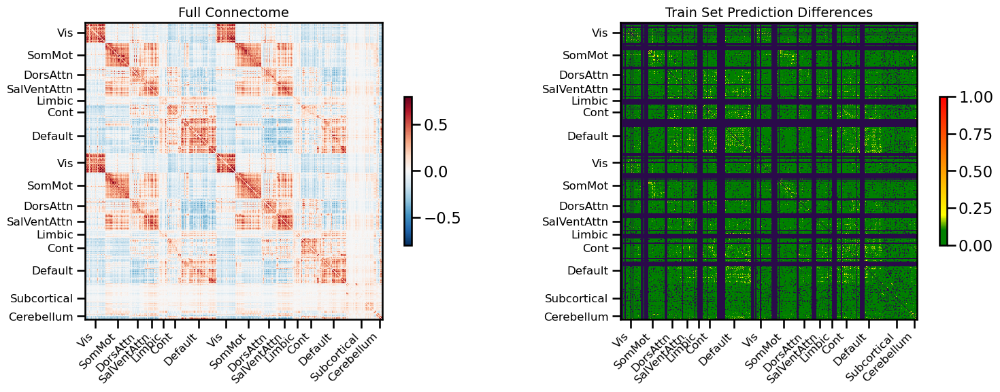

<Figure size 640x480 with 0 Axes>

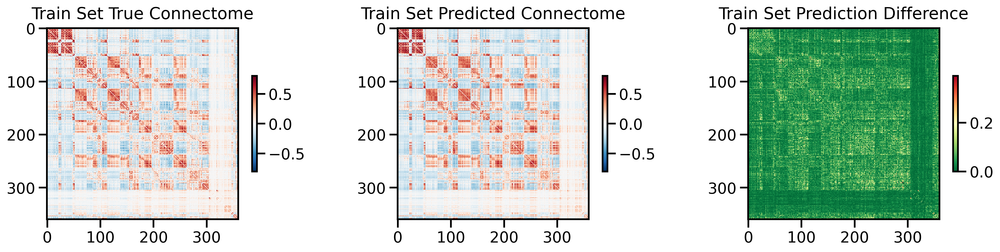

<Figure size 640x480 with 0 Axes>

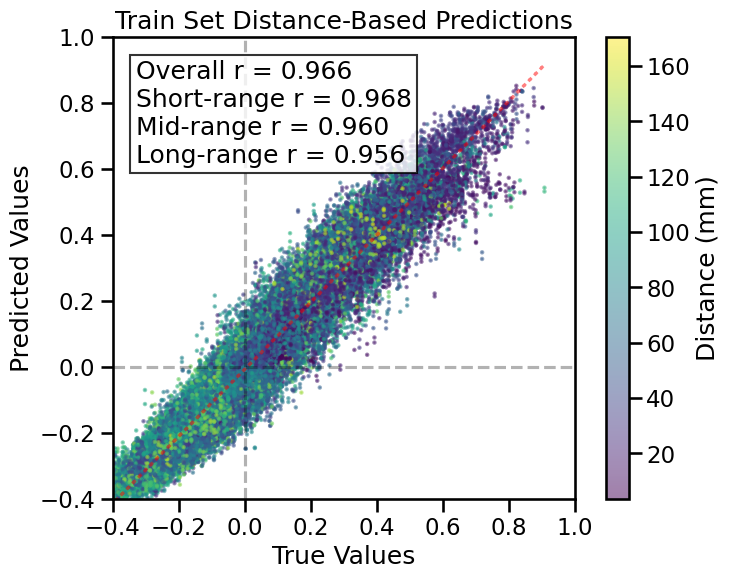

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 95 regions, 8930 connections


<Figure size 640x480 with 0 Axes>

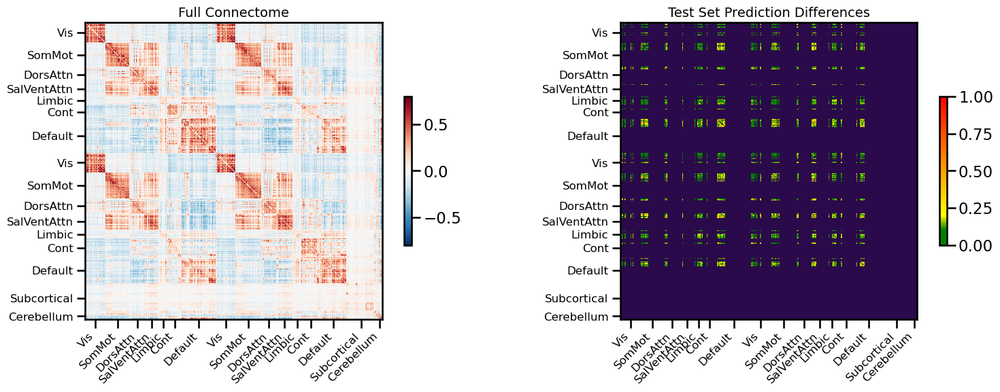

<Figure size 640x480 with 0 Axes>

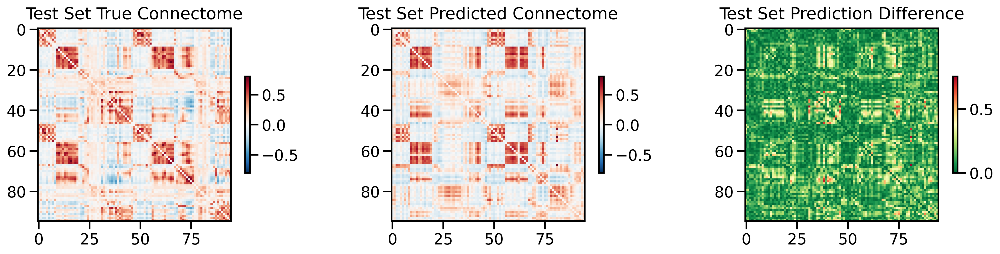

<Figure size 640x480 with 0 Axes>

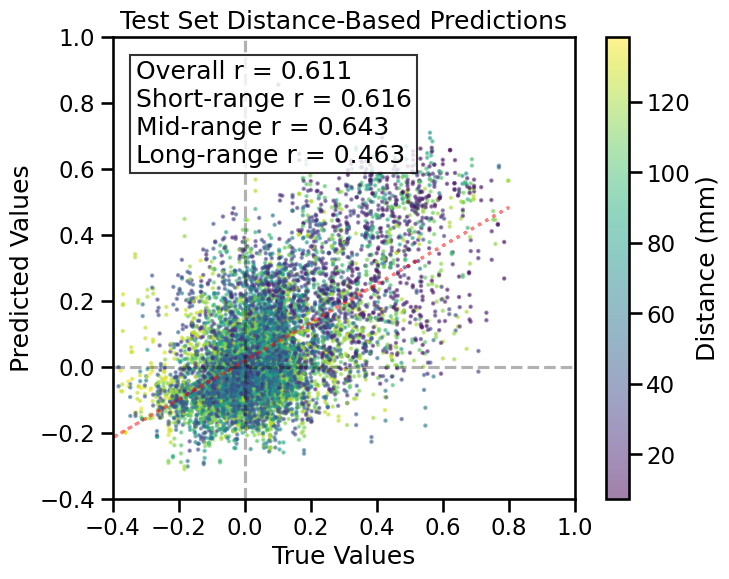

TRAIN METRICS
GLOBAL: mse=0.002710, mae=0.038172, r2=0.9245, pearson_r=0.9659, spearman_r=0.9598, geodesic_distance=15.5914
DISTANCE-BASED: short=0.9684, mid=0.9596, long=0.9559
HEMISPHERIC: left=0.9656, right=0.9685, inter=0.9663
CONNECTION STRENGTH: neg=0.5279, weak=0.9414, pos=0.7824
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9703    0.9705
  Default       0.9727    0.9700
  SalVentAttn    0.9680    0.9701
  Limbic        0.9740    0.9681
  DorsAttn      0.9641    0.9727
  SomMot        0.9717    0.9743
  Vis           0.9866    0.9772
  Subcortical    0.9614    0.9674
  Cerebellum    0.9237    0.9666

TEST METRICS
GLOBAL: mse=0.026519, mae=0.122797, r2=0.2532, pearson_r=0.6113, spearman_r=0.5286, geodesic_distance=10.0908
DISTANCE-BASED: short=0.6159, mid=0.6430, long=0.4630
HEMISPHERIC: left=0.6070, right=0.6087, inter=0.6098
CONNECTION STRENGTH: weak=0.3994, pos=0.3198
NETWORK CORRELATIONS:
  NETWORK      INTRA      IN


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,█▅▄▃▃▄▄▄▄▄▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▂▁▂▁▂▂▂▁▂
train_mse_loss,█▅▄▃▃▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.02694
train_mse_loss,0.00464


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: or8c94gs
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/or8c94gs
Initialized sweep with ID: or8c94gs



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.




Testing network: Occipital
Temporal
Parietal
Frontal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'epochs': 90, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 2173067



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.10 GB


W0726 14:42:57.128000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/15] ps1 is not in var_ranges, defaulting to unknown range.
W0726 14:42:57.133000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/15] ps1 is not in var_ranges, defaulting to unknown range.
W0726 14:43:09.829000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/16] ps1 is not in var_ranges, defaulting to unknown range.
W0726 14:43:09.833000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/16] ps1 is not in var_ranges, defaulting to unknown range.


Best val loss so far at epoch 1: 0.1566
Best val loss so far at epoch 5: 0.1556
Epoch 5/90, Train Loss: 0.0661, Val Loss: 0.1556, Time: 5.07s
Best val loss so far at epoch 6: 0.1500
Best val loss so far at epoch 7: 0.1498
Best val loss so far at epoch 8: 0.1419
Best val loss so far at epoch 9: 0.1418
Best val loss so far at epoch 10: 0.1369
Epoch 10/90, Train Loss: 0.0414, Val Loss: 0.1369, Time: 5.12s
Epoch 15/90, Train Loss: 0.0354, Val Loss: 0.1451, Time: 5.10s
Best val loss so far at epoch 17: 0.1263
Best val loss so far at epoch 20: 0.1199
Epoch 20/90, Train Loss: 0.0298, Val Loss: 0.1199, Time: 5.05s
Best val loss so far at epoch 22: 0.0953
Best val loss so far at epoch 23: 0.0847
Best val loss so far at epoch 25: 0.0771
Epoch 25/90, Train Loss: 0.0244, Val Loss: 0.0771, Time: 6.36s
Best val loss so far at epoch 27: 0.0698
Best val loss so far at epoch 29: 0.0668
Best val loss so far at epoch 30: 0.0569
Epoch 30/90, Train Loss: 0.0202, Val Loss: 0.0569, Time: 4.96s
Best val loss 

<Figure size 640x480 with 0 Axes>

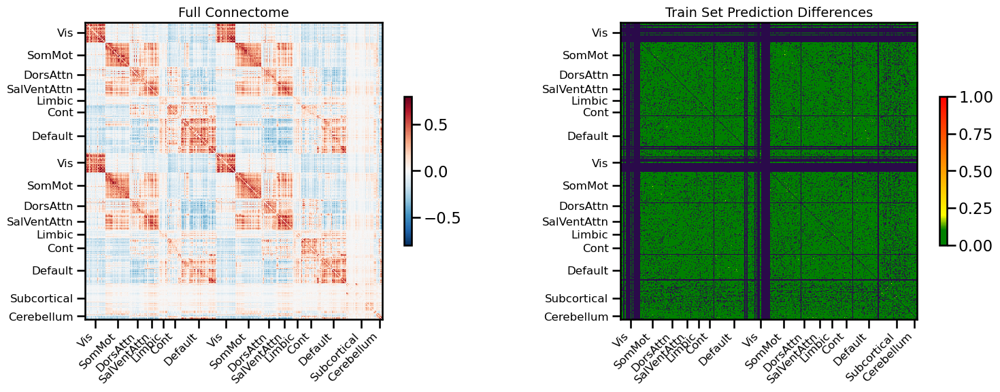

<Figure size 640x480 with 0 Axes>

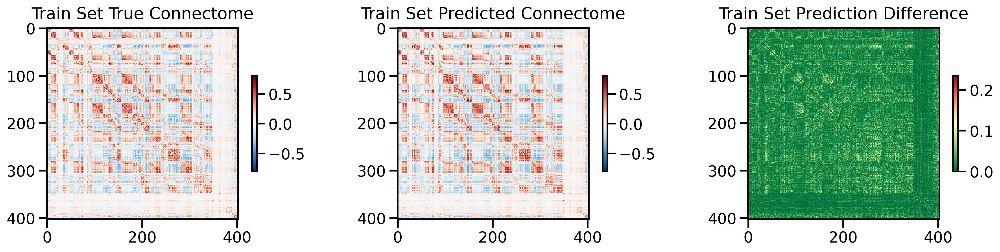

<Figure size 640x480 with 0 Axes>

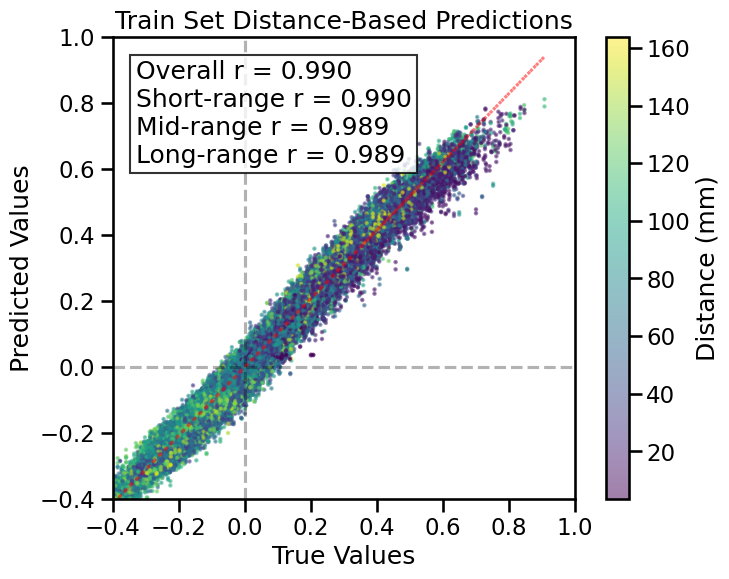

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 52 regions, 2652 connections


<Figure size 640x480 with 0 Axes>

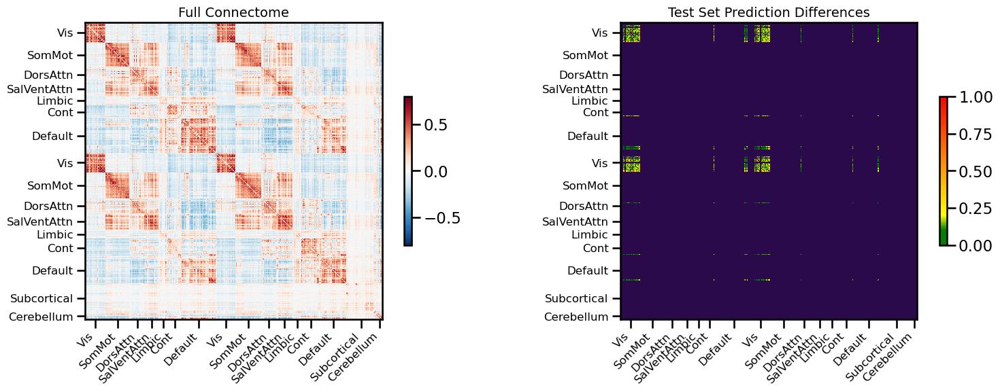

<Figure size 640x480 with 0 Axes>

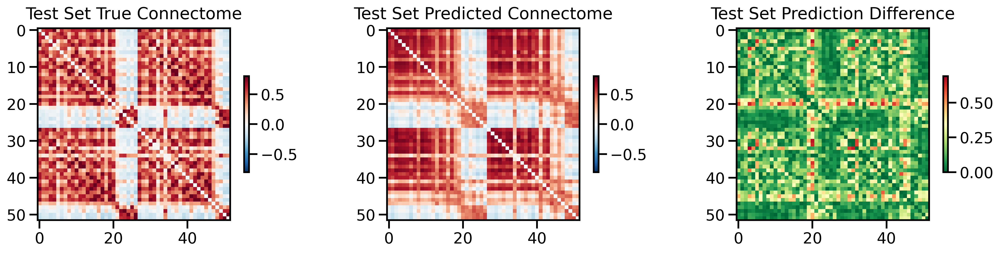

<Figure size 640x480 with 0 Axes>

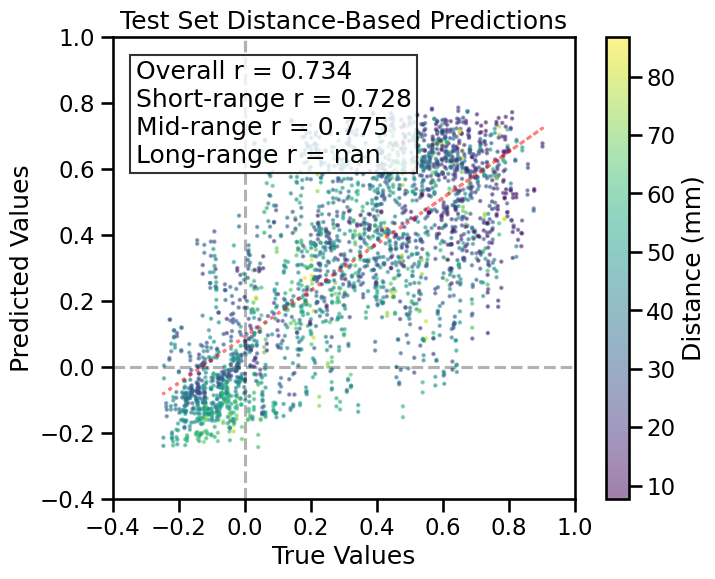

TRAIN METRICS
GLOBAL: mse=0.000790, mae=0.020970, r2=0.9758, pearson_r=0.9895, spearman_r=0.9860, geodesic_distance=15.2186
DISTANCE-BASED: short=0.9895, mid=0.9891, long=0.9887
HEMISPHERIC: left=0.9896, right=0.9900, inter=0.9892
CONNECTION STRENGTH: neg=0.7967, weak=0.9818, pos=0.9214
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9923    0.9907
  Default       0.9915    0.9902
  SalVentAttn    0.9903    0.9906
  Limbic        0.9931    0.9926
  DorsAttn      0.9867    0.9889
  SomMot        0.9868    0.9888
  Vis           0.9785    0.9788
  Subcortical    0.9934    0.9904
  Cerebellum    0.8191    0.9903

TEST METRICS
GLOBAL: mse=0.044516, mae=0.160567, r2=0.4896, pearson_r=0.7338, spearman_r=0.7041, geodesic_distance=4.2682
DISTANCE-BASED: short=0.7282, mid=0.7754
HEMISPHERIC: left=0.7306, right=0.7278, inter=0.7371
CONNECTION STRENGTH: weak=0.6837, pos=0.1986
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  --------


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,████▇▇▇▇▇▇▄▄▃▄▂▂▂▂▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.04455
train_mse_loss,0.00224


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: bfcmzdxm
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/bfcmzdxm
Initialized sweep with ID: bfcmzdxm



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.




Testing network: Parietal
Temporal
Occipital
Frontal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'epochs': 90, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 2173067



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display





Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.10 GB


W0726 14:51:46.242000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/17] ps1 is not in var_ranges, defaulting to unknown range.
W0726 14:51:46.247000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/17] ps1 is not in var_ranges, defaulting to unknown range.
W0726 14:51:57.178000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/18] ps1 is not in var_ranges, defaulting to unknown range.
W0726 14:51:57.183000 22600473347904 torch/fx/experimental/symbolic_shapes.py:4449] [0/18] ps1 is not in var_ranges, defaulting to unknown range.


Best val loss so far at epoch 1: 0.0688
Best val loss so far at epoch 2: 0.0624
Best val loss so far at epoch 3: 0.0611
Best val loss so far at epoch 4: 0.0594
Epoch 5/90, Train Loss: 0.0751, Val Loss: 0.0651, Time: 3.86s
Epoch 10/90, Train Loss: 0.0472, Val Loss: 0.0978, Time: 3.94s
Epoch 15/90, Train Loss: 0.0306, Val Loss: 0.0844, Time: 3.67s
Epoch 20/90, Train Loss: 0.0278, Val Loss: 0.0655, Time: 3.73s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.061018
Epoch 25/90, Train Loss: 0.0226, Val Loss: 0.0635, Time: 6.41s
Epoch 30/90, Train Loss: 0.0186, Val Loss: 0.0596, Time: 3.53s
Epoch 35/90, Train Loss: 0.0204, Val Loss: 0.0619, Time: 3.61s
Best val loss so far at epoch 37: 0.0587
Best val loss so far at epoch 39: 0.0569
Best val loss so far at epoch 40: 0.0549
Epoch 40/90, Train Loss: 0.0154, Val Loss: 0.0549, Time: 3.48s
Epoch 45/90, Train Loss: 0.0151, Val Loss: 0.0581, Time: 3.51s
Best val loss so far at epoch 47: 0.0547
Best val loss so far at epoch 50: 0.0544
Epoch 50/90, T

<Figure size 640x480 with 0 Axes>

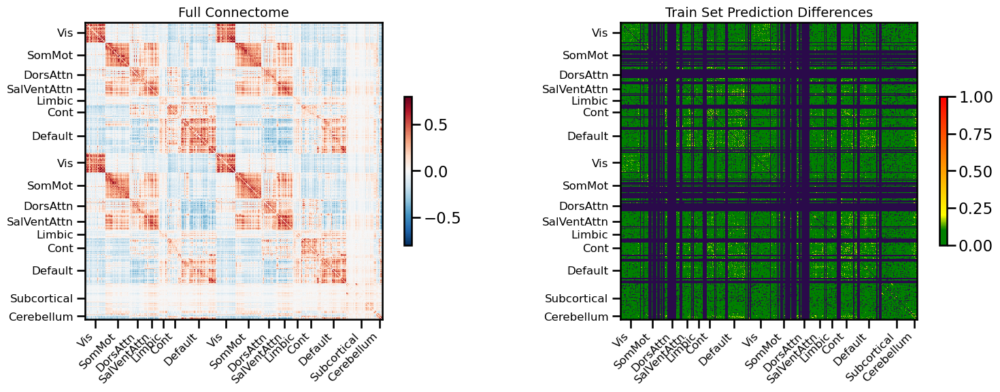

<Figure size 640x480 with 0 Axes>

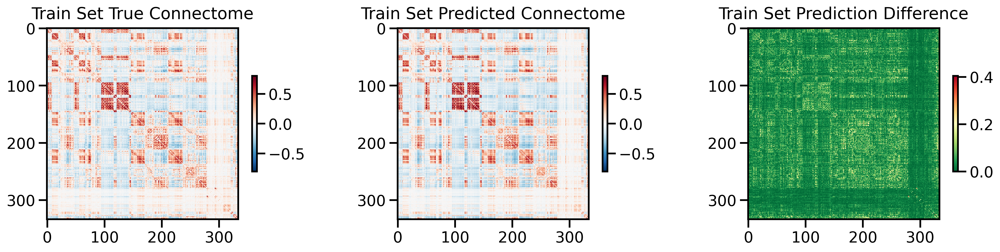

<Figure size 640x480 with 0 Axes>

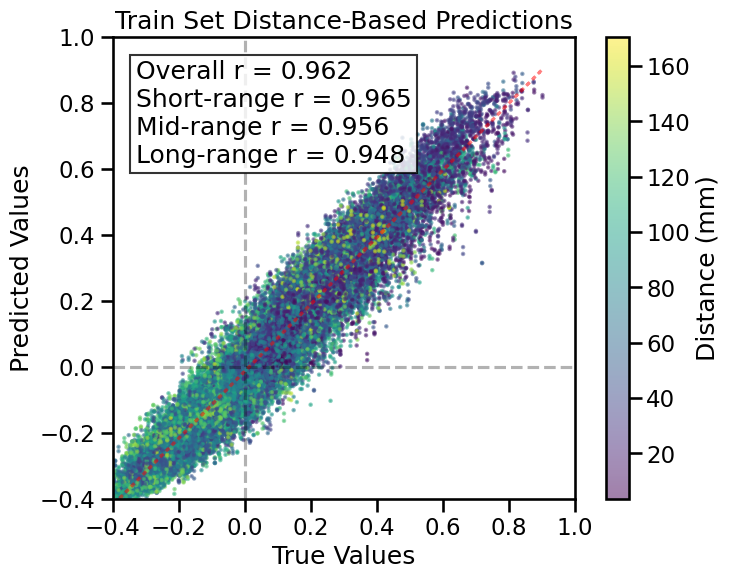

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 121 regions, 14520 connections


<Figure size 640x480 with 0 Axes>

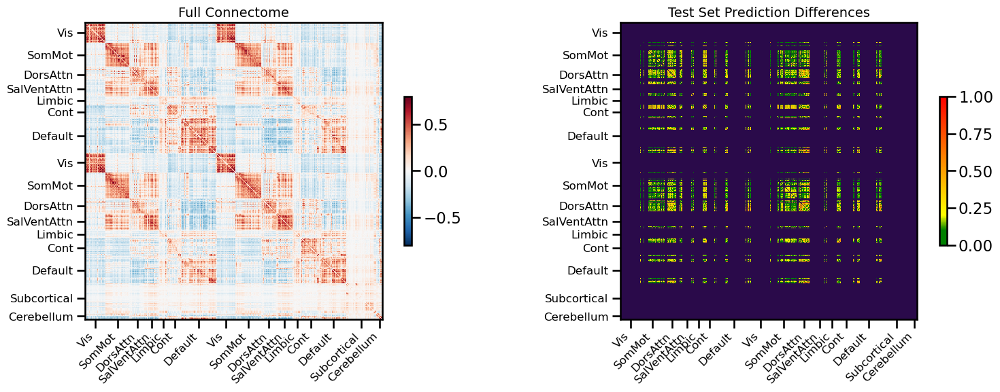

<Figure size 640x480 with 0 Axes>

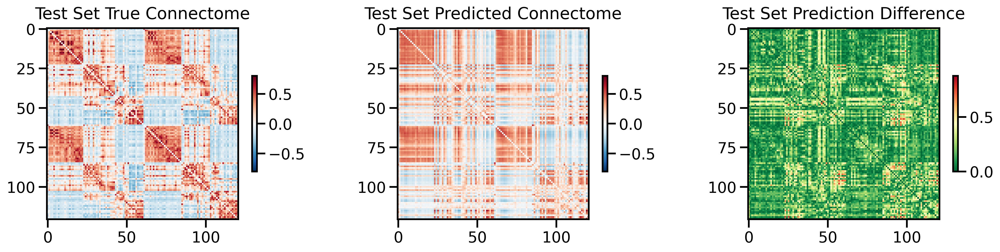

<Figure size 640x480 with 0 Axes>

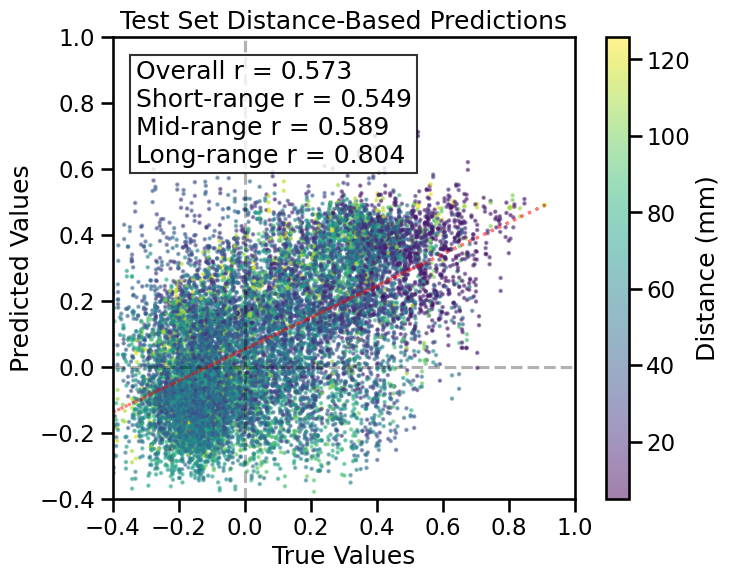

TRAIN METRICS
GLOBAL: mse=0.002719, mae=0.038207, r2=0.9127, pearson_r=0.9623, spearman_r=0.9481, geodesic_distance=17.0452
DISTANCE-BASED: short=0.9651, mid=0.9556, long=0.9479
HEMISPHERIC: left=0.9598, right=0.9637, inter=0.9624
CONNECTION STRENGTH: neg=0.5354, weak=0.9306, pos=0.8215
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9747    0.9643
  Default       0.9413    0.9571
  SalVentAttn    0.9425    0.9553
  Limbic        0.9714    0.9740
  DorsAttn      0.9804    0.9711
  SomMot        0.9707    0.9640
  Vis           0.9573    0.9655
  Subcortical    0.9879    0.9615
  Cerebellum    0.8532    0.9671

TEST METRICS
GLOBAL: mse=0.047143, mae=0.168028, r2=0.2518, pearson_r=0.5725, spearman_r=0.5539, geodesic_distance=12.7840
DISTANCE-BASED: short=0.5485, mid=0.5894, long=0.8038
HEMISPHERIC: left=0.5869, right=0.5950, inter=0.5700
CONNECTION STRENGTH: neg=0.0036, weak=0.4115, pos=0.1870
NETWORK CORRELATIONS:
  NETWORK      I


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,▅▃▃▄▆██▇▇▆▄▃▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.04857
train_mse_loss,0.00418


Final evaluation metrics logged successfully.
CPU Usage: 2.5%
RAM Usage: 16.9%
Available RAM: 1.2T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 1354.02 seconds (22.57 minutes)


8709

<Figure size 640x480 with 0 Axes>

In [21]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='lobe',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True, 
              null_model='none',
              use_folds=[0, 1, 2]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()